In [11]:
import pandas as pd
import numpy as np
import chart_studio.plotly as py
import cufflinks as cf
import seaborn as sns
import plotly.express as px
%matplotlib inline

from plotly.offline import download_plotlyjs, init_notebook_mode,plot
init_notebook_mode(connected=True)
cf.go_offline()

BASICS


<Axes: >

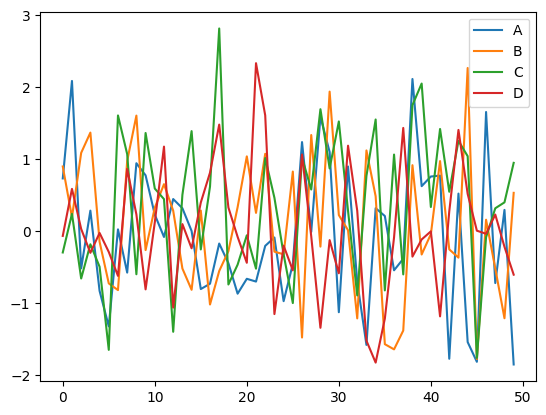

In [14]:
arr_1 = np.random.randn(50,4)
df_1 = pd.DataFrame(arr_1, columns=['A','B','C','D'])
df_1.head()
df_1.plot()

##### df_1.iplot()

LINE PLOT

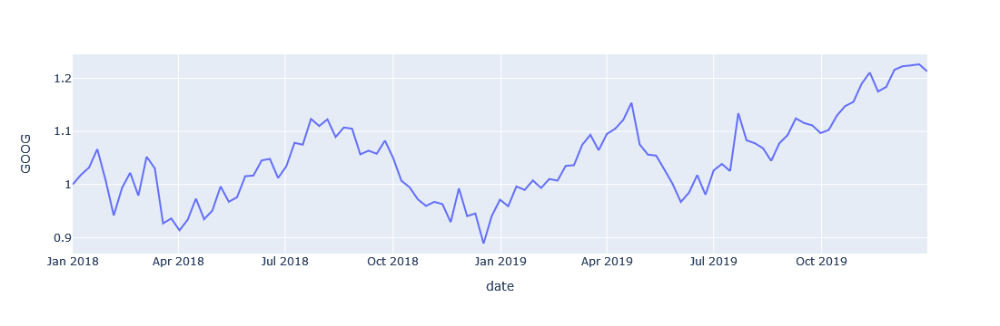

In [21]:
import plotly.graph_objects as go
df_stocks = px.data.stocks()
px.line(df_stocks, x='date', y='GOOG', labels={'x' : 'Date', 'y' : 'Price'})

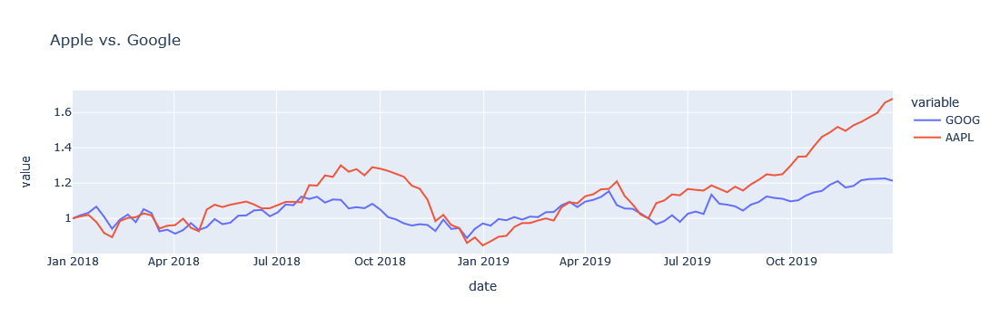

In [23]:
px.line(df_stocks, x='date', y=['GOOG','AAPL'], labels={'x' : 'Date', 'y' : 'Price'}, title='Apple vs. Google')

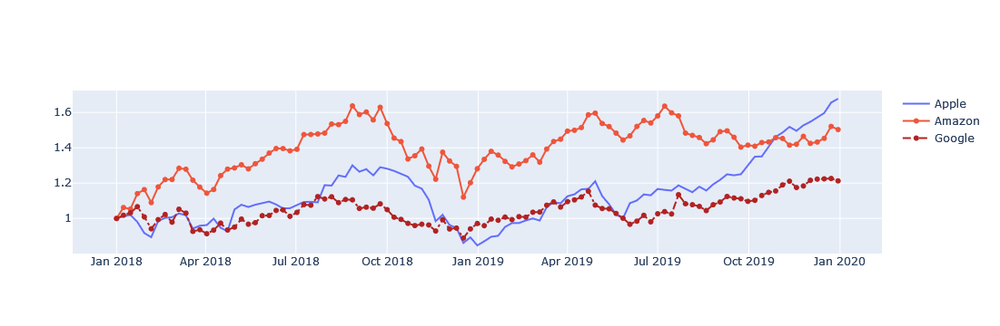

In [24]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_stocks.date, y=df_stocks.AAPL, mode='lines', name='Apple'))
fig.add_trace(go.Scatter(x=df_stocks.date, y=df_stocks.AMZN, mode='lines+markers', name='Amazon'))
fig.add_trace(go.Scatter(x=df_stocks.date, y=df_stocks.GOOG, mode='lines+markers', name='Google', line=dict(color='firebrick', width=2, dash='dashdot')))

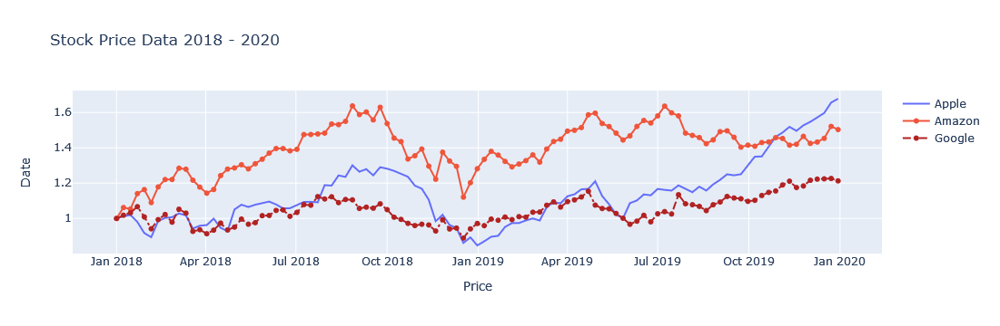

In [25]:
fig.update_layout(title='Stock Price Data 2018 - 2020', xaxis_title='Price', yaxis_title='Date')

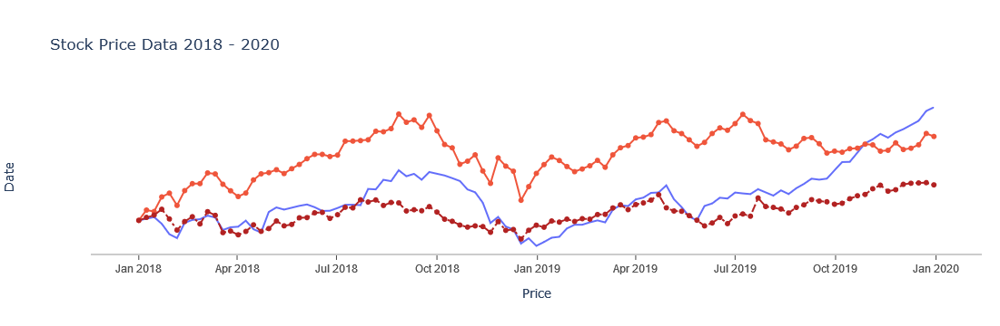

In [27]:
fig.update_layout(xaxis=dict(showline=True, showgrid=False, showticklabels=True, 
                             linecolor='rgb(204,204,204)', linewidth=2, ticks='outside', 
                             tickfont=dict(family='Arial', size=12, color='rgb(82,82,82)',
                                          ),
                            ),
                  yaxis=dict(showline=False, showgrid=False, showticklabels=False, zeroline=False ),
                  autosize=False, margin=dict(autoexpand=False, l=100, r=20, t=110, ),
                  showlegend=False, plot_bgcolor='white'
                 )



BAR CHARTS

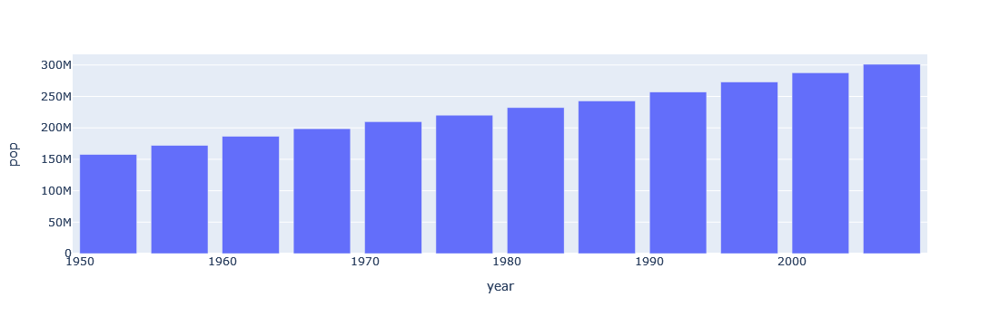

In [31]:
df_us = px.data.gapminder().query("country == 'United States' ")
px.bar(df_us, x='year' , y='pop' )

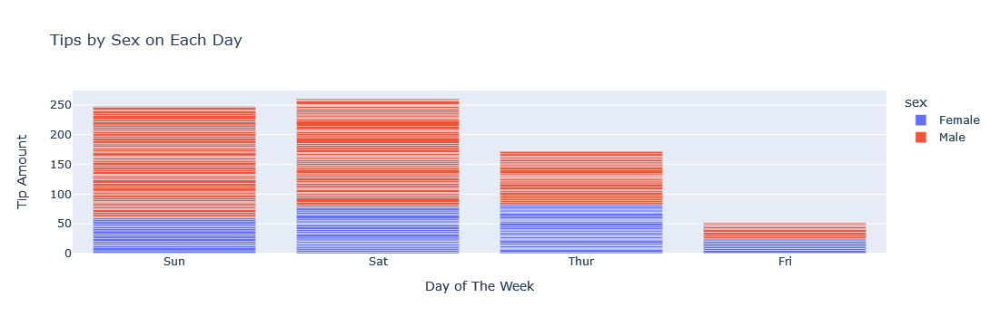

In [32]:
df_tips = px.data.tips()
px.bar(df_tips, x='day', y='tip', color='sex', title='Tips by Sex on Each Day', labels={'tip':'Tip Amount', 'day':'Day of The Week'})

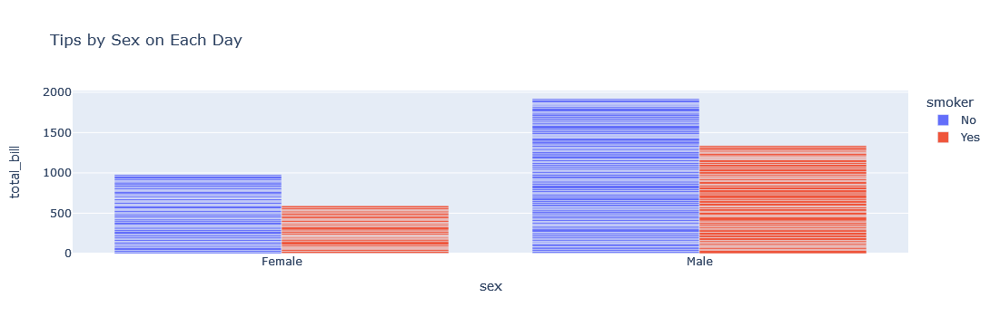

In [34]:
px.bar(df_tips, x='sex', y='total_bill', color='smoker', title='Tips by Sex on Each Day', 
       barmode='group',labels={'tip':'Tip Amount', 'day':'Day of The Week'})

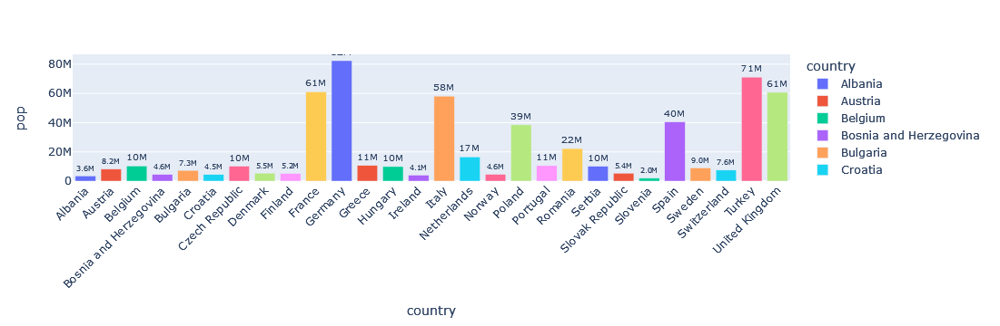

In [39]:
df_europe = px.data.gapminder().query("continent == 'Europe' and year == 2007 and pop > 2.e6 ")
fig = px.bar(df_europe, y='pop', x='country', text='pop', color='country' )

fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8)
fig.update_layout(xaxis_tickangle= -45 )

fig

SCATTER PLOTS

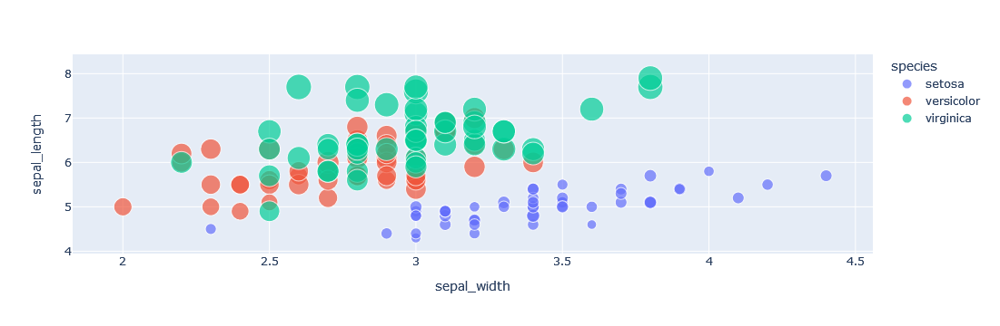

In [40]:
df_iris = px.data.iris()
px.scatter(df_iris, x='sepal_width', y='sepal_length', color='species', size='petal_length', hover_data=['petal_width'])

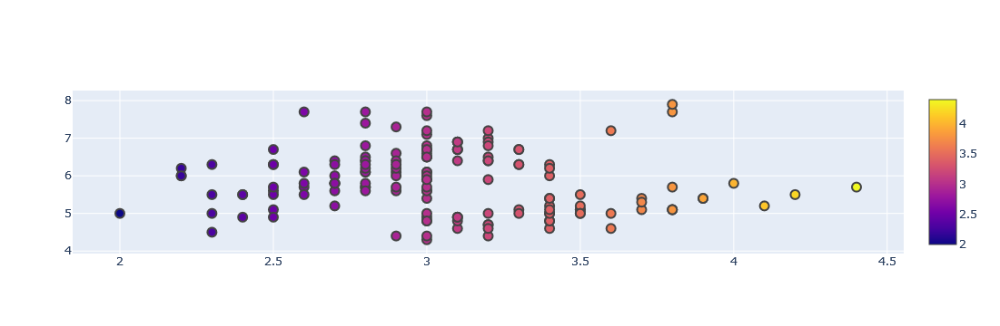

In [42]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=df_iris.sepal_width,y=df_iris.sepal_length, mode='markers', marker_color=df_iris.sepal_width, text=df_iris.species, 
                         marker=dict(showscale=True)))
fig.update_traces(marker_line_width=2, marker_size=10)

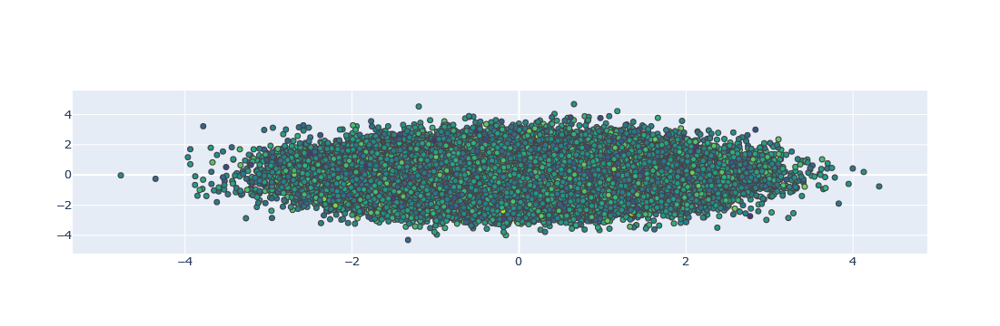

In [45]:
fig=go.Figure(data=go.Scattergl(x=np.random.randn(100000),
                               y=np.random.randn(100000),
                               mode='markers', 
                                marker = dict(
                                    color=np.random.randn(100000),
                                    colorscale='Viridis',
                                    line_width=1
                                         )))
fig

PIE CHARTS

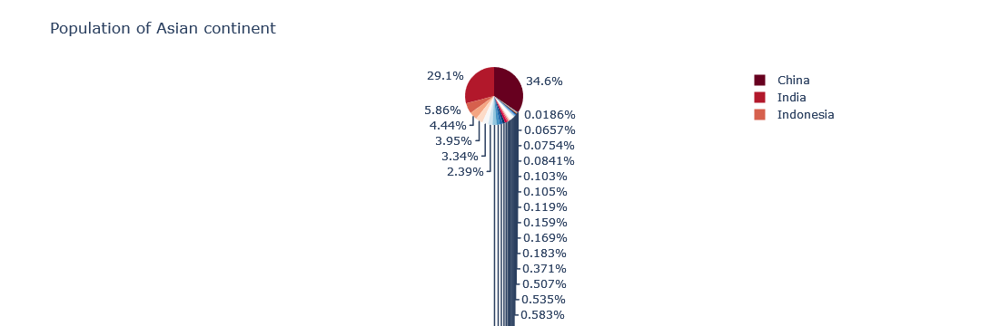

In [49]:
df_asia = px.data.gapminder().query("year == 2007").query("continent == 'Asia'")
px.pie(df_asia, values='pop', names='country', title='Population of Asian continent',
      color_discrete_sequence=px.colors.sequential.RdBu)


In [50]:
colors = ['blue','green','black', 'purple', 'red','brown']

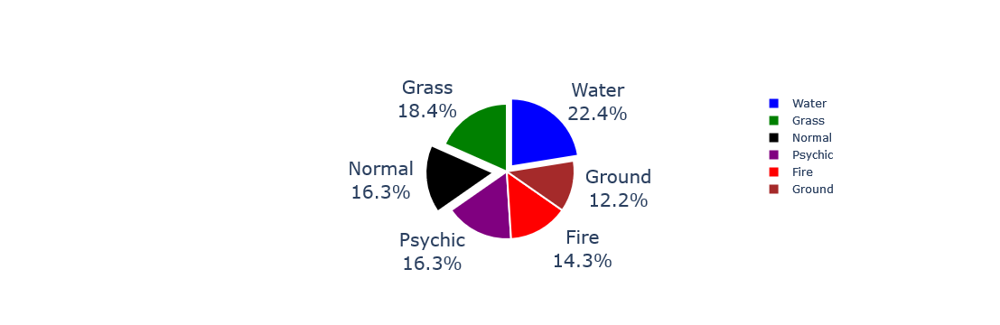

In [55]:
fig = go.Figure(data=[go.Pie(labels=['Water','Grass','Normal','Psychic', 'Fire','Ground'],
                            values=[110, 90, 80, 80, 70, 60])])
fig.update_traces(hoverinfo='label+percent', textfont_size=20,
                 textinfo ='label+percent', 
                 pull=[0.1, 0, 0.2, 0, 0, 0],
                 marker=dict(colors=colors, line=dict(color='#FFFFFF', width=2)))
fig

HISTOGRAM

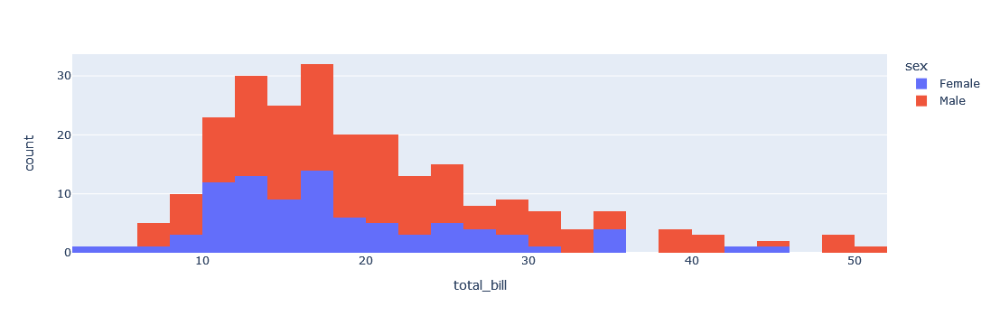

In [60]:
dice_1 = np.random.randint(1, 7, 5000)
dice_2 = np.random.randint(1, 7, 5000)
dice_sum = dice_1 + dice_2
fig = px.histogram(dice_sum, nbins=11, labels={'value':'Dice Roll'},
                  title = '5000 Dice Roll Histogram',
                  marginal='violin',
                  color_discrete_sequence=['green'])

fig.update_layout(
xaxis_title_text='Dice Roll', 
yaxis_title_text='Dice Sum',
bargap=0.3,
showlegend=False)

df_tips = px.data.tips()
px.histogram(df_tips, x='total_bill', color='sex')



BOX PLOTS

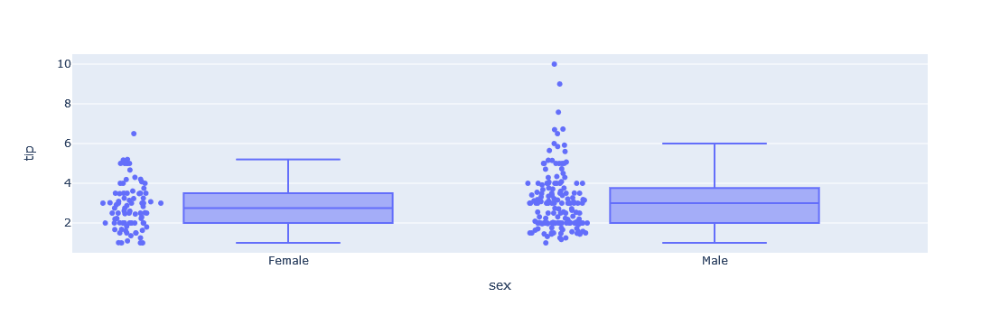

In [61]:
df_tips = px.data.tips()
px.box(df_tips, x='sex', y='tip', points='all')

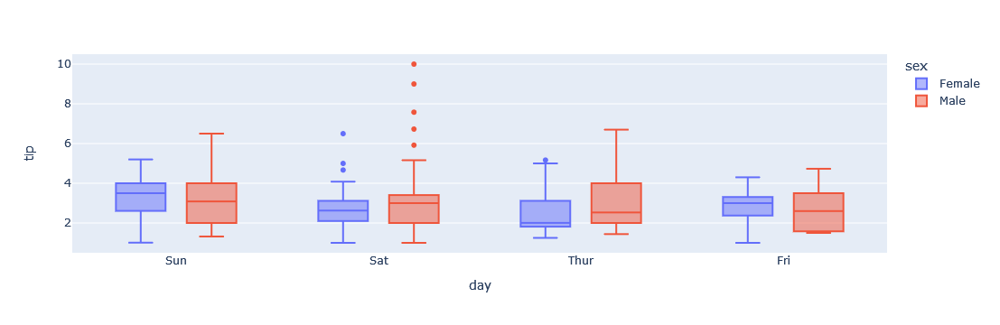

In [62]:
px.box(df_tips, x='day', y='tip', color='sex')

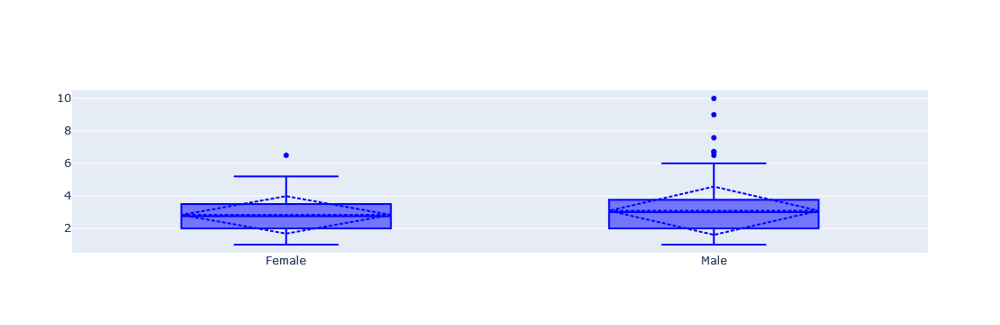

In [63]:
fig = go.Figure()
fig.add_trace(go.Box(x = df_tips.sex, y = df_tips.tip, marker_color='blue', boxmean='sd'))

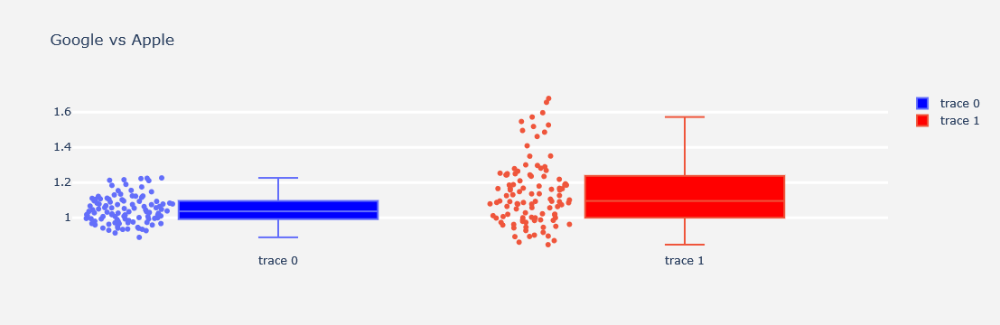

In [64]:
df_stocks = px.data.stocks()
fig=go.Figure()
fig.add_trace(go.Box(y=df_stocks.GOOG, boxpoints='all', fillcolor='blue', jitter=0.5, whiskerwidth=0.2))
fig.add_trace(go.Box(y=df_stocks.AAPL, boxpoints='all', fillcolor='red', jitter=0.5, whiskerwidth=0.2))
fig.update_layout(title='Google vs Apple', yaxis=dict(gridcolor='rgb(255,255,255)',
                                                     gridwidth=3),
                 paper_bgcolor='rgb(243,243,243)',
                 plot_bgcolor='rgb(243,243,243)')

VIOLIN PLOTS

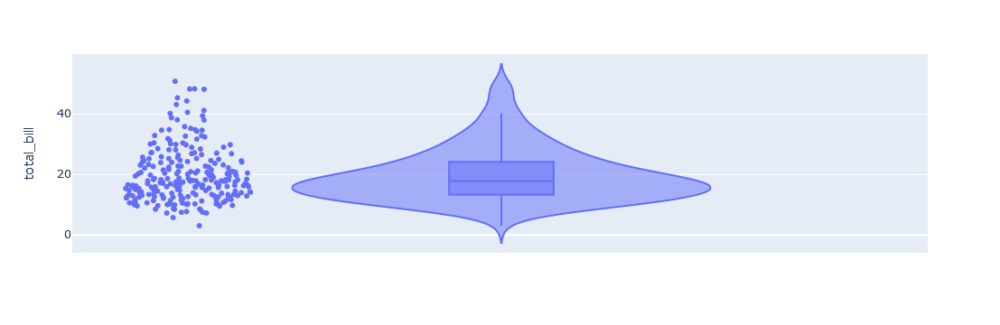

In [65]:
df_tips = px.data.tips()
px.violin(df_tips, y="total_bill", box=True, points='all')

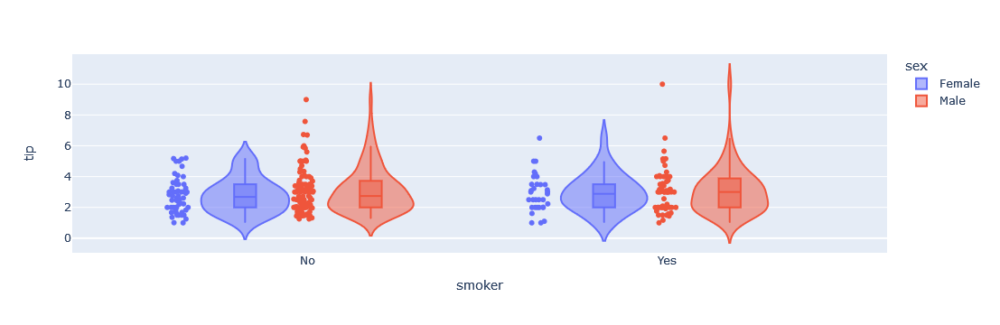

In [66]:
px.violin(df_tips, y="tip", x='smoker', color='sex', box=True, points="all", hover_data=df_tips.columns)

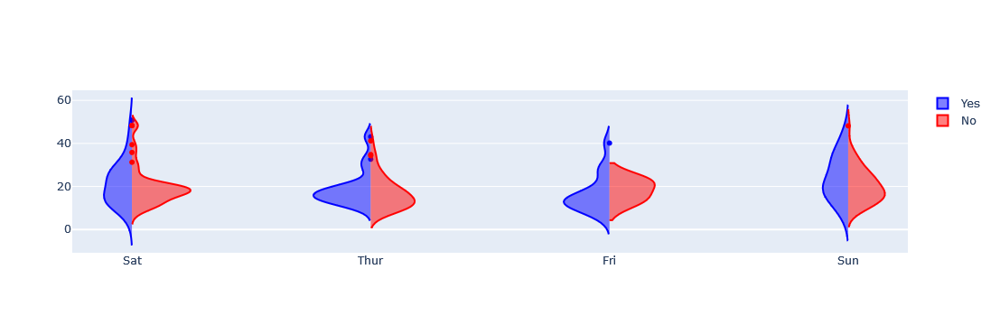

In [71]:
fig = go.Figure()
fig.add_trace(go.Violin(x=df_tips['day'][df_tips['smoker']=='Yes'],
                       y=df_tips['total_bill'][df_tips['smoker']=='Yes'],
                       legendgroup='Yes', scalegroup='Yes', name='Yes', side='negative', line_color='blue'))
fig.add_trace(go.Violin(x=df_tips['day'][df_tips['smoker']=='No'],
                       y=df_tips['total_bill'][df_tips['smoker']=='No'],
                       legendgroup='Yes', scalegroup='Yes', name='No', side='positive', line_color='red'))

DENSITY HEATMAPS

In [72]:
flights = sns.load_dataset("flights")
flights

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121
...,...,...,...
139,1960,Aug,606
140,1960,Sep,508
141,1960,Oct,461
142,1960,Nov,390


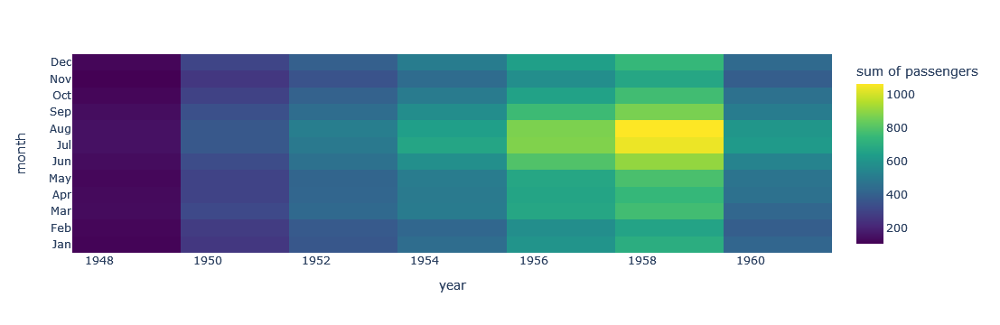

In [73]:
fig = px.density_heatmap(flights, x='year', y='month', z='passengers', color_continuous_scale='Viridis' )
fig

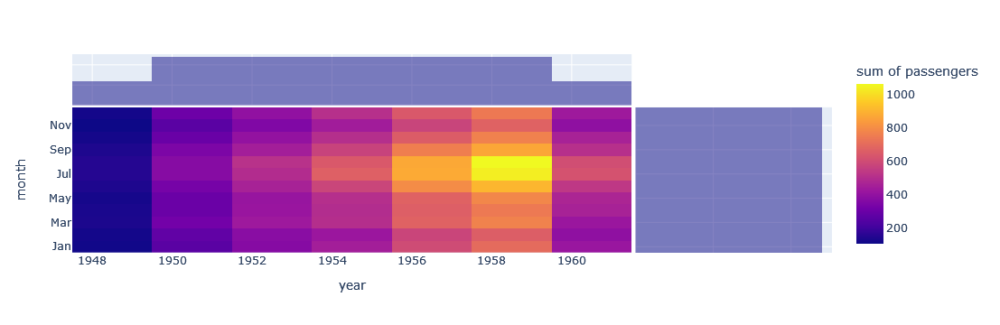

In [77]:
fig = px.density_heatmap(flights, x='year', y='month', z='passengers',
                        marginal_x='histogram', marginal_y='histogram')
fig

3D SCATTER PLOTS

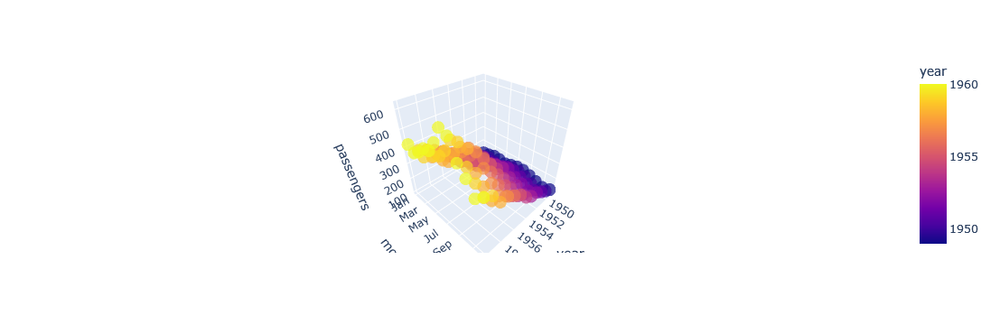

In [78]:
fig = px.scatter_3d(flights, x='year', y='month', z='passengers',
                   color='year', opacity=0.7)
fig

3D LINE PLOTS

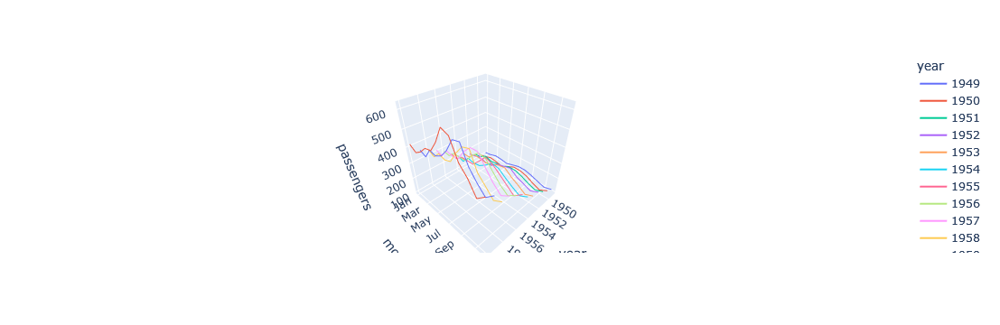

In [80]:
fig = px.line_3d(flights, x='year', y='month', z='passengers',  color='year')
fig

SCATTER MATRIX

C:\Users\33689\AppData\Local\Programs\Python\Python311\Lib\site-packages\plotly\express\_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



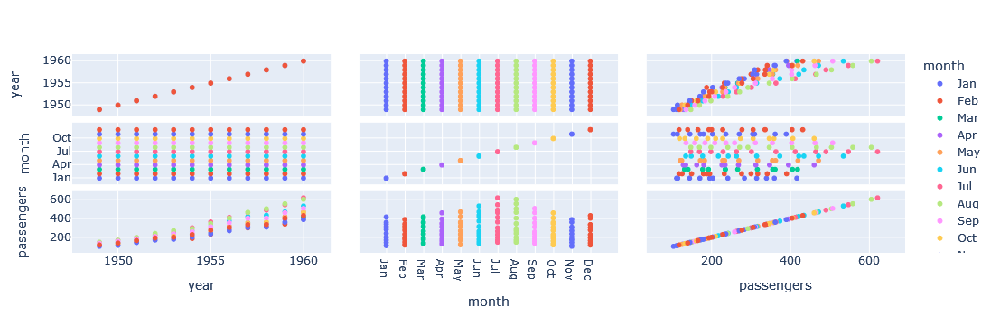

In [83]:
fig = px.scatter_matrix(flights, color='month')
fig

MAP SCATTER PLOTS

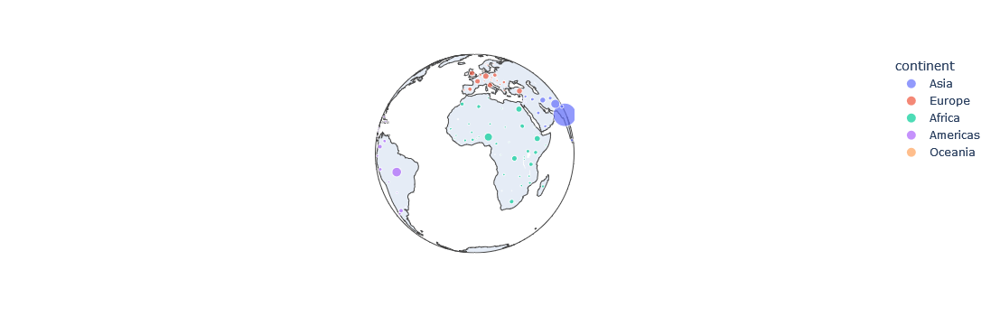

In [84]:
df = px.data.gapminder().query("year == 2007")
fig = px.scatter_geo(df, locations="iso_alpha", color="continent", hover_name='country', size='pop', projection='orthographic')
fig

CHOROPLETH MAP

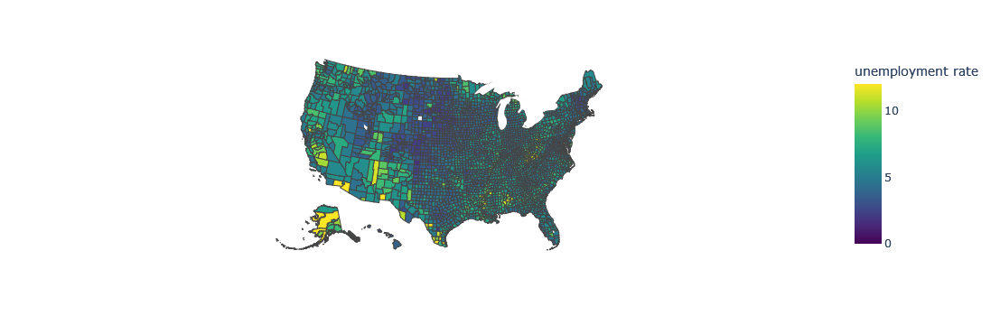

In [88]:
from urllib.request import urlopen
import json
with urlopen('http://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties=json.load(response)

df = pd.read_csv('http://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv', 
                 dtype={"fips": str})

fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                    color_continuous_scale="Viridis",
                    range_color=(0,12),
                    scope="usa",
                    labels={'unemp' : 'unemployment rate'}
                   )
fig

POLAR CHARTS

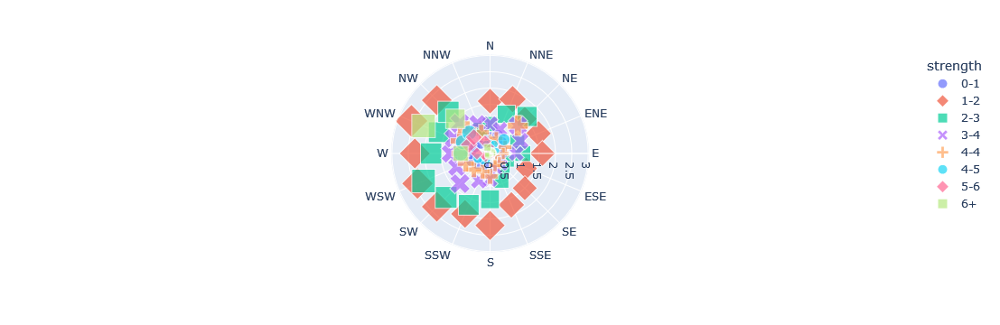

In [90]:
df_wind = px.data.wind()
px.scatter_polar(df_wind, r="frequency", theta="direction", color="strength", size="frequency", symbol="strength")

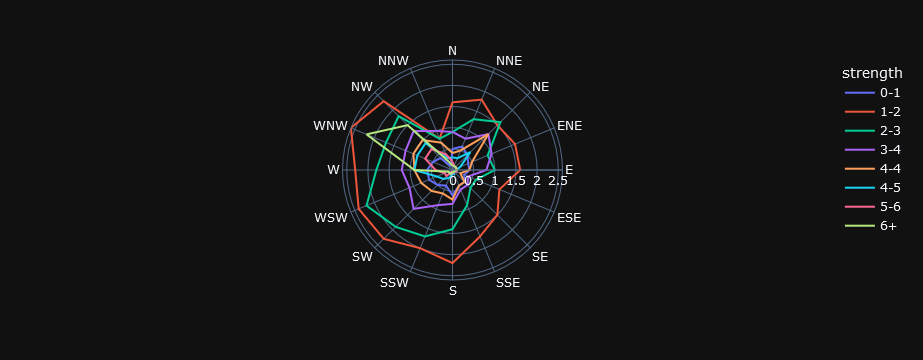

In [91]:
df_wind = px.data.wind()
px.line_polar(df_wind, r="frequency", theta="direction", color="strength", line_close=True, template="plotly_dark")

TERNARY PLOTS

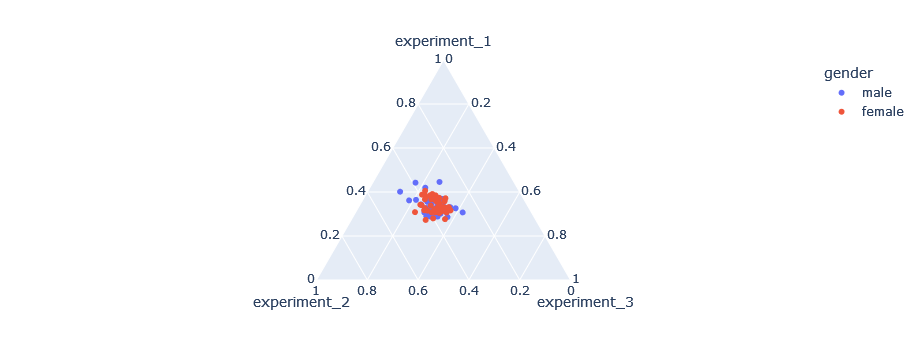

In [92]:
df_exp = px.data.experiment()
px.scatter_ternary(df_exp, a="experiment_1",b="experiment_2",c="experiment_3", hover_name="group", color="gender")

FACET PLOTS

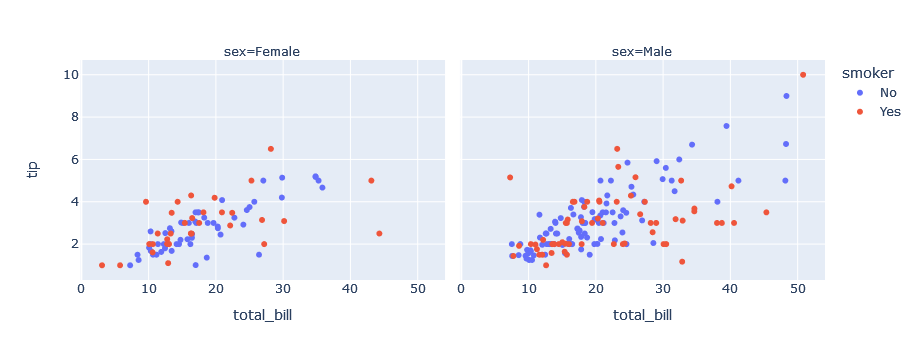

In [93]:
df_tips = px.data.tips()
px.scatter(df_tips, x="total_bill", y="tip", color="smoker", facet_col="sex")

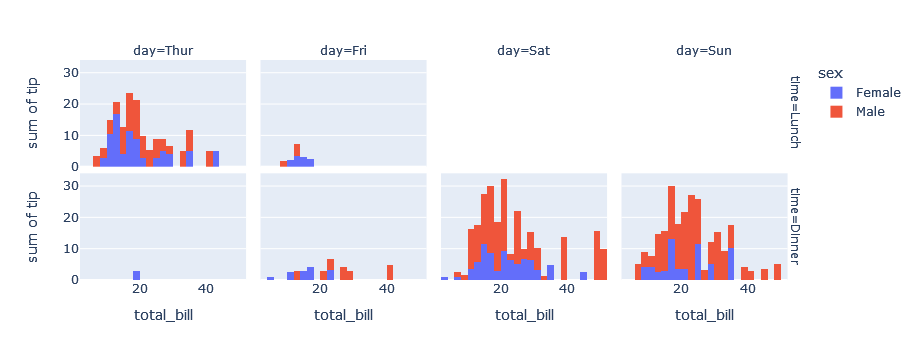

In [96]:
px.histogram(df_tips, x="total_bill", y="tip", color="sex", facet_row="time", facet_col="day",
             category_orders={"day":["Thur","Fri","Sat","Sun"],
                            "time":["Lunch","Dinner"]})

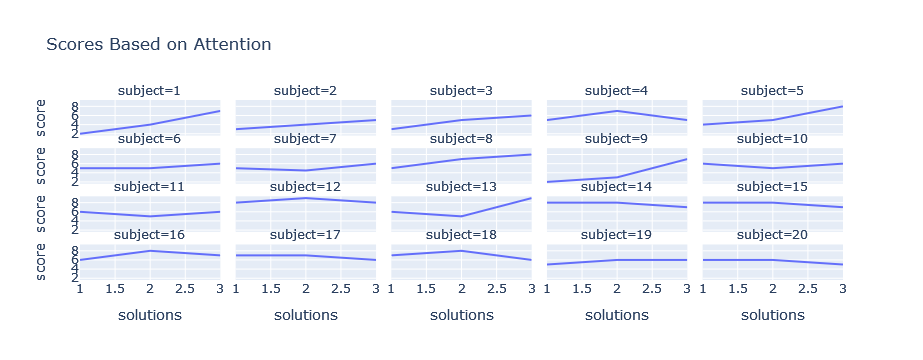

In [97]:
att_df = sns.load_dataset("attention")
fig = px.line(att_df, x="solutions",y="score", facet_col='subject', facet_col_wrap=5, title="Scores Based on Attention")
fig

ANIMATED PLOTS

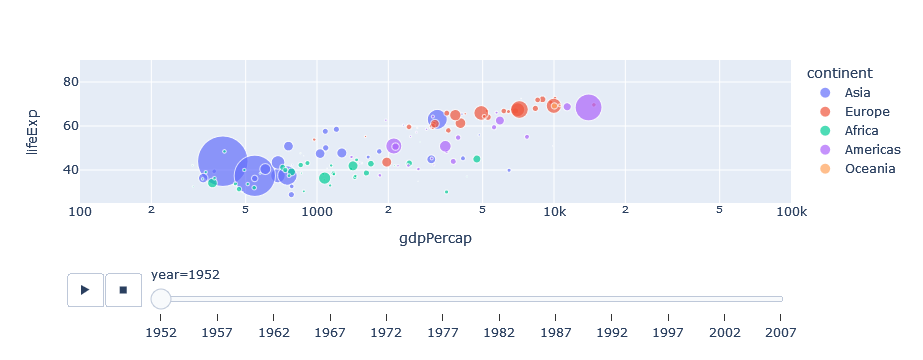

In [98]:
df_cnt = px.data.gapminder()
px.scatter(df_cnt, x="gdpPercap", y="lifeExp", animation_frame="year", animation_group="country",
           size="pop", color="continent", hover_name="country", log_x=True, size_max=55, range_x=[100, 100000],
          range_y=[25,90])

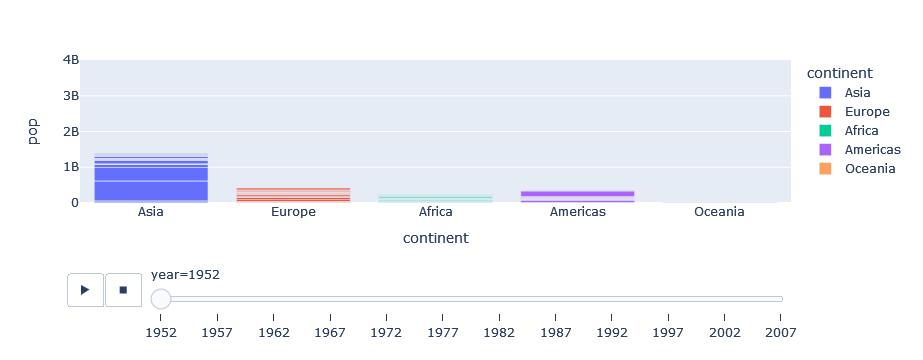

In [99]:
px.bar(df_cnt, x="continent", y="pop", color="continent", animation_frame="year", animation_group="country",
      range_y=[0, 4000000000])